#### Imports

In [2]:
import numpy as np
import math
import matplotlib.pyplot as plt

#### 0.Tests 

In [3]:
N = 100

In [5]:
# 1 n est pas un nombre premier 
L = [2]

for i in range(3,N+1):
    #print("/",i,": La longuer de L est ",m)
    p = 1

    for j in L:
        #print ('On test',j)
        if j != i:
            k = i%j
            p = p*k 

    if p != 0:
        L.append(i)


In [6]:
print("N =",N)
print("Voici la liste des nombres premiers <= N:",L)
print("Il y a",len(L),"nombres premiers parmis les",N ,"premiers nombres entiers")


N = 100
Voici la liste des nombres premiers <= N: [2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31, 37, 41, 43, 47, 53, 59, 61, 67, 71, 73, 79, 83, 89, 97]
Il y a 25 nombres premiers parmis les 100 premiers nombres entiers


#### On va créer une fonction qui fait le même travail

Version « minimale »

In [7]:
from typing import List

In [8]:
# fonction renvoyant la liste des L premiers entiers compris entre 1 et N.

def premiers_jusqua(N: int) -> List[int]:
    """Retourne la liste des nombres premiers ≤ N par divisions d'essai."""
    if N < 2:
        return []
    L = [2]
    # on ne teste que les impairs car on sait que tous les pairs sont divisbles par 2
    for i in range(3, N + 1, 2):
        est_premier = True
        for j in L:
            if j * j > i:      # arrêt anticipé au-delà de sqrt(i)
                break
            if i % j == 0:     # dès qu'on trouve un diviseur, on s'arrête
                est_premier = False
                break
        if est_premier:
            L.append(i)
    return L


In [9]:
# Liste des nombres premiers juque 1000.

M = 10000
for i in range (M):
    print (premiers_jusqua(i))

[]
[]
[2]
[2, 3]
[2, 3]
[2, 3, 5]
[2, 3, 5]
[2, 3, 5, 7]
[2, 3, 5, 7]
[2, 3, 5, 7]
[2, 3, 5, 7]
[2, 3, 5, 7, 11]
[2, 3, 5, 7, 11]
[2, 3, 5, 7, 11, 13]
[2, 3, 5, 7, 11, 13]
[2, 3, 5, 7, 11, 13]
[2, 3, 5, 7, 11, 13]
[2, 3, 5, 7, 11, 13, 17]
[2, 3, 5, 7, 11, 13, 17]
[2, 3, 5, 7, 11, 13, 17, 19]
[2, 3, 5, 7, 11, 13, 17, 19]
[2, 3, 5, 7, 11, 13, 17, 19]
[2, 3, 5, 7, 11, 13, 17, 19]
[2, 3, 5, 7, 11, 13, 17, 19, 23]
[2, 3, 5, 7, 11, 13, 17, 19, 23]
[2, 3, 5, 7, 11, 13, 17, 19, 23]
[2, 3, 5, 7, 11, 13, 17, 19, 23]
[2, 3, 5, 7, 11, 13, 17, 19, 23]
[2, 3, 5, 7, 11, 13, 17, 19, 23]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31, 37]
[2, 3, 5, 7, 11, 13, 17, 19, 23, 29, 31, 37]
[2, 3, 5, 7,

#### Le crible d’Ératosthène 
C'est l’un des algorithmes les plus anciens et efficaces pour trouver tous les nombres premiers jusqu’à un entier donné 𝑁.
Il remonte à Ératosthène de Cyrène (IIIᵉ siècle av. J.-C.).

In [12]:
def crible_eratosthene(N: int):
    """Retourne un tableau booléen où True signifie 'premier'."""
    is_prime = np.ones(N + 1, dtype=bool)
    is_prime[:2] = False
    for p in range(2, int(math.isqrt(N)) + 1):
        if is_prime[p]:
            is_prime[p*p:N+1:p] = False
    return is_prime

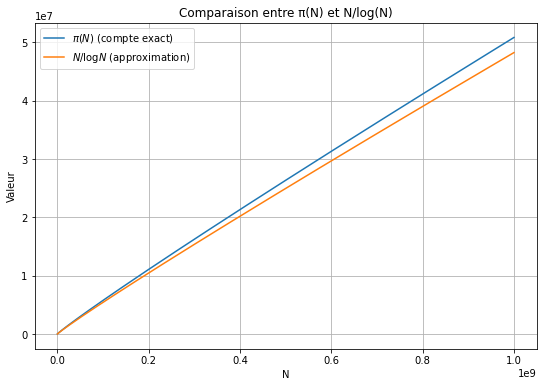

In [13]:
# Paramètre : borne max
MAX_N = 1_000_000_000

# Crible et comptage cumulatif π(N)
is_prime = crible_eratosthene(MAX_N)
pi = np.cumsum(is_prime.astype(int))  # π(n) = nombre de nombres premiers ≤ n

# Points d'échantillonnage (progression géométrique pour lisibilité)
N_vals = np.unique(np.round(np.geomspace(10, MAX_N, num=400)).astype(int))

pi_vals = pi[N_vals]
approx_vals = N_vals / np.log(N_vals)

# Tracé
plt.figure(figsize=(9, 6))
plt.plot(N_vals, pi_vals, label=r"$\pi(N)$ (compte exact)")
plt.plot(N_vals, approx_vals, label=r"$N/\log N$ (approximation)")
plt.title("Comparaison entre π(N) et N/log(N)")
plt.xlabel("N")
plt.ylabel("Valeur")
plt.legend()
plt.grid(True)
plt.show()